# Programming Project #2: Image Quilting

## CS445: Computational Photography


In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
from random import random
import time

# modify to where you store your project data including utils.py
datadir = "/content/drive/My Drive/cs445_projects/proj2/"

utilfn = datadir + "utils.py"
!cp "$utilfn" .
samplesfn = datadir + "samples"
!cp -r "$samplesfn" .
import utils

cp: /content/drive/My Drive/cs445_projects/proj2/utils.py: No such file or directory
cp: /content/drive/My Drive/cs445_projects/proj2/samples: No such file or directory


In [10]:
from utils import cut

### Part I: Randomly Sampled Texture (10 pts)

In [5]:
def quilt_random(sample, out_size, patch_size):
    """
    Randomly samples square patches of size patch_size from sample in order to create an output image of size out_size.

    :param sample: numpy.ndarray   The image you read from sample directory
    :param out_size: int            The width of the square output image
    :param patch_size: int          The width of the square sample patch
    :return: numpy.ndarray
    """
    sample_h, sample_w, sample_c = sample.shape
    output = np.zeros((out_size, out_size, sample_c), dtype=sample.dtype) 
    for i in range(0, out_size - patch_size, patch_size):
        for j in range(0, out_size - patch_size, patch_size):
            rand_x = np.random.randint(0, sample_h - patch_size)
            rand_y = np.random.randint(0, sample_w - patch_size)
            patch = sample[rand_x:rand_x + patch_size, rand_y:rand_y + patch_size, :]
            output[i:i + patch_size, j:j + patch_size, :] = patch

    return output


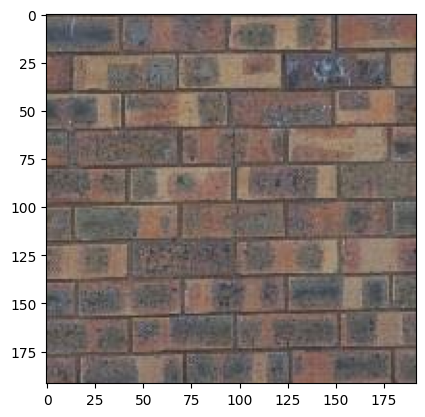

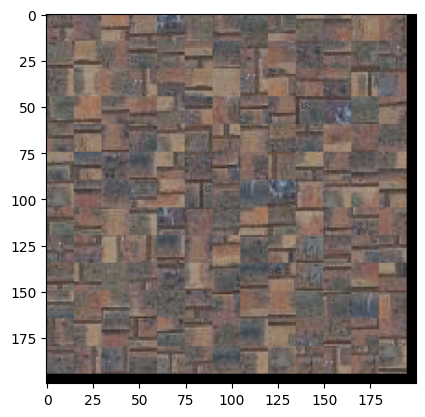

In [6]:
sample_img_fn = 'samples/bricks_small.jpg' # feel free to change
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 200  # change these parameters as needed
patch_size = 15
res = quilt_random(sample_img, out_size, patch_size)
if res is not None:
    plt.imshow(res)

### Part II: Overlapping Patches (30 pts)

In [7]:
# def quilt_simple(sample, out_size, patch_size, overlap, tol):
#     """
#     Randomly samples square patches of size patchsize from sample in order to create an output image of size outsize.
#     Feel free to add function parameters
#     :param sample: numpy.ndarray
#     :param out_size: int
#     :param patch_size: int
#     :param overlap: int
#     :param tol: float
#     :return: numpy.ndarray
#     """


In [8]:
import numpy as np
import cv2

def ssd_patch(T, M, I):
    ssd_cost = ((M*T)**2).sum() - 2 * cv2.filter2D(I, ddepth=-1, kernel = M*T) + cv2.filter2D(I ** 2, ddepth=-1, kernel=M)
    return np.sum(ssd_cost, axis=-1) 

def choose_sample(cost, tol):
    flat_indices = np.argsort(cost.ravel())[:tol]  # Get indices of tol smallest costs
    chosen_idx = np.random.choice(flat_indices)  # Randomly select one of them
    return np.unravel_index(chosen_idx, cost.shape)  # Convert back to 2D index

def quilt_simple(sample, out_size, patch_size, overlap, tol):
    """Generates a new texture by quilting patches from a sample image."""
    output = np.zeros((out_size, out_size, sample.shape[2]), dtype=sample.dtype)  # Output canvas
    # Start with a random patch for the upper-left corner
    i, j = np.random.randint(0, sample.shape[0] - patch_size), np.random.randint(0, sample.shape[1] - patch_size)
    output[:patch_size, :patch_size, :] = sample[i:i+patch_size, j:j+patch_size, :]
    
    for y in range(0, out_size - patch_size + 1 , patch_size - overlap):
        for x in range(0, out_size - patch_size + 1, patch_size - overlap):
            if y == 0 and x == 0:
                continue  # Skip the first patch (already placed)
            
            template = np.zeros((patch_size, patch_size, sample.shape[2]))
            mask = np.zeros((patch_size, patch_size, sample.shape[2]))
            
            if y > 0:
                template[:overlap, :, :] = output[y:y+overlap, x:x+patch_size, :]
                mask[:overlap, :, :] = 1
            if x > 0:
                template[:, :overlap, :] = output[y:y+patch_size, x:x+overlap, :]
                mask[:, :overlap, :] = 1
            
            ssd_cost = ssd_patch(template, mask, sample)
            # print(ssd_cost.shape)
            valid_h, valid_w = sample.shape[0] - patch_size, sample.shape[1] - patch_size
            ssd_cost = ssd_cost[:valid_h, :valid_w]

            i, j = choose_sample(ssd_cost, tol)
            if ((y+patch_size) < out_size) and ((x+patch_size) < out_size):
                output[y:y+patch_size, x:x+patch_size, :] = sample[i:i+patch_size, j:j+patch_size, :]
    return output


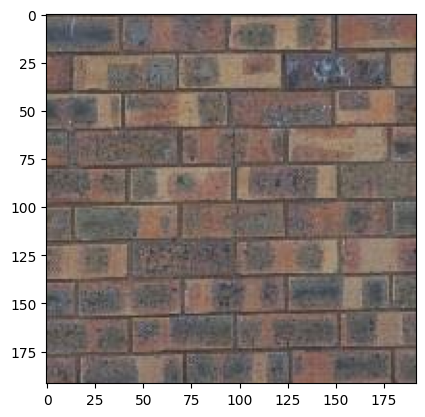

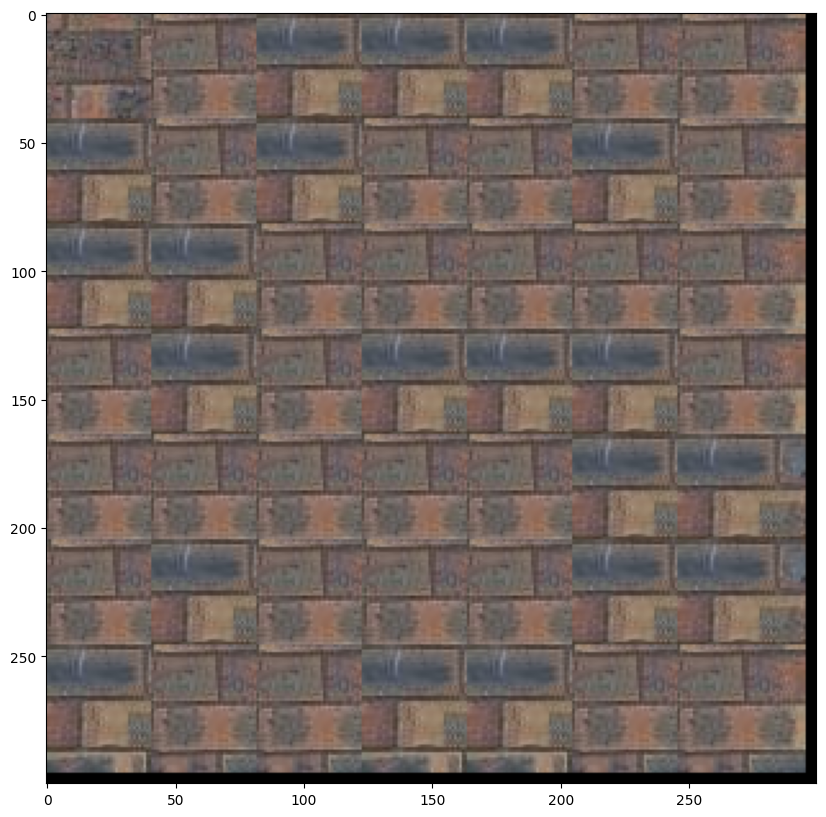

In [9]:
sample_img_fn = 'samples/bricks_small.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 300  # change these parameters as needed
patch_size = 50
overlap = 9
tol = 3
res = quilt_simple(sample_img, out_size, patch_size, overlap, tol) #feel free to change parameters to get best results
if res is not None:
    plt.figure(figsize=(10,10))
    plt.imshow(res)

### Part III: Seam Finding (20 pts)


In [10]:
# optional or use cut(err_patch) directly
def customized_cut(bndcost):
    pass

In [50]:
import numpy as np
import matplotlib.pyplot as plt

def illustrate_patch(template, patch, bnd_cost,mask_h, mask_v, mask):
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    axes[0, 0].imshow(template.astype(np.uint8))
    axes[0, 0].set_title("Template Patch")
    
    axes[0, 1].imshow(patch.astype(np.uint8))
    axes[0, 1].set_title("Selected Patch")

    axes[0, 2].imshow(bnd_cost, cmap='hot')
    axes[0, 2].set_title("SSD Cost")

    # Masks
    axes[1, 0].imshow(mask_v[:, :, 0], cmap='gray')
    axes[1, 0].set_title("Horizontal Mask")

    axes[1, 1].imshow(mask_h[:, :, 0], cmap='gray')
    axes[1, 1].set_title("Vertical Mask")

    axes[1, 2].imshow(mask[:, :, 0], cmap='gray')
    axes[1, 2].set_title("Combination Mask")

    plt.tight_layout()
    plt.show()


In [51]:
def quilt_cut(sample, out_size, patch_size, overlap, tol):
    """
    Samples square patches of size patchsize from sample using seam finding in order to create an output image of size outsize.
    Feel free to add function parameters
    :param sample: numpy.ndarray
    :param out_size: int
    :param patch_size: int
    :param overlap: int
    :param tol: float
    :return: numpy.ndarray
    """

    output = np.zeros((out_size, out_size, sample.shape[2]), dtype=sample.dtype) 
    i, j = np.random.randint(0, sample.shape[0] - patch_size), np.random.randint(0, sample.shape[1] - patch_size)
    output[:patch_size, :patch_size, :] = sample[i:i+patch_size, j:j+patch_size, :]
    
    for y in range(0, out_size - patch_size + 1 , patch_size - overlap):
        for x in range(0, out_size - patch_size + 1, patch_size - overlap):
            if y == 0 and x == 0:
                continue  
            
            template = np.zeros((patch_size, patch_size, sample.shape[2]))
            mask = np.zeros((patch_size, patch_size, sample.shape[2]))
            
            if y > 0:
                template[:overlap, :, :] = output[y:y+overlap, x:x+patch_size, :]
                mask[:overlap, :, :] = 1
            if x > 0:
                template[:, :overlap, :] = output[y:y+patch_size, x:x+overlap, :]
                mask[:, :overlap, :] = 1
            
            ssd_cost = ssd_patch(template, mask, sample)
            valid_h, valid_w = sample.shape[0] - patch_size, sample.shape[1] - patch_size
            ssd_cost = ssd_cost[:valid_h, :valid_w]

            i, j = choose_sample(ssd_cost, tol)
            patch = sample[i:i+patch_size, j:j+patch_size, :]
            mask_v = np.zeros((patch_size, patch_size, sample.shape[2]))
            mask_h = np.zeros((patch_size, patch_size, sample.shape[2]))
            mask = np.zeros((patch_size, patch_size, 3)) 
            bnd_cost =  np.zeros((patch_size, patch_size)) 
            if y > 0:
                vertical_error = (output[y:y+overlap, x:x+patch_size, :] - patch[:overlap, :, :])**2
                bndcost_v = vertical_error.sum(axis=2)  # Sum over color channels
                mask1 = 1-cut(bndcost_v)
                # print(mask_v.shape)
                bnd_cost[:overlap, :] = bndcost_v
                mask_v[:overlap, :, :] = np.repeat(mask1[:, :, np.newaxis], 3, axis=2)
            if x > 0:
                horizontal_error = (output[y:y+patch_size, x:x+overlap, :] - patch[:, :overlap, :])**2
                bndcost_h = horizontal_error.sum(axis=2)  # Sum over color channels
                # np.repeat(a[:, :, np.newaxis], 3, axis=2) https://stackoverflow.com/questions/32171917/how-to-copy-a-2d-array-into-a-3rd-dimension-n-times

                mask2 = 1-cut(bndcost_h.T).T 
                bnd_cost[:, :overlap] = bndcost_h
                # print(mask_h.shape)
                mask_h[:, :overlap, :] = np.repeat(mask2[:, :, np.newaxis], 3, axis=2)
            # print(mask_v.shape, mask_h.shape)
            mask = np.logical_or(mask_v, mask_h).astype(np.uint8)
            
            if ((y+patch_size) < out_size) and ((x+patch_size) < out_size):
                output[y:y+patch_size, x:x+patch_size, :] = patch * (1-mask) + output[y:y+patch_size, x:x+patch_size, :] * ( mask)
            

            # if (x==patch_size - overlap and y == patch_size - overlap):
            #     illustrate_patch(template, patch, bnd_cost, mask_h, mask_v, mask)
            
    
    return output



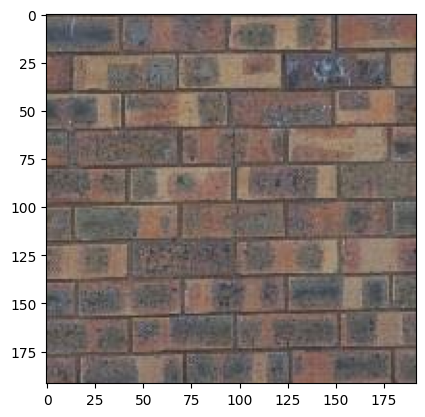

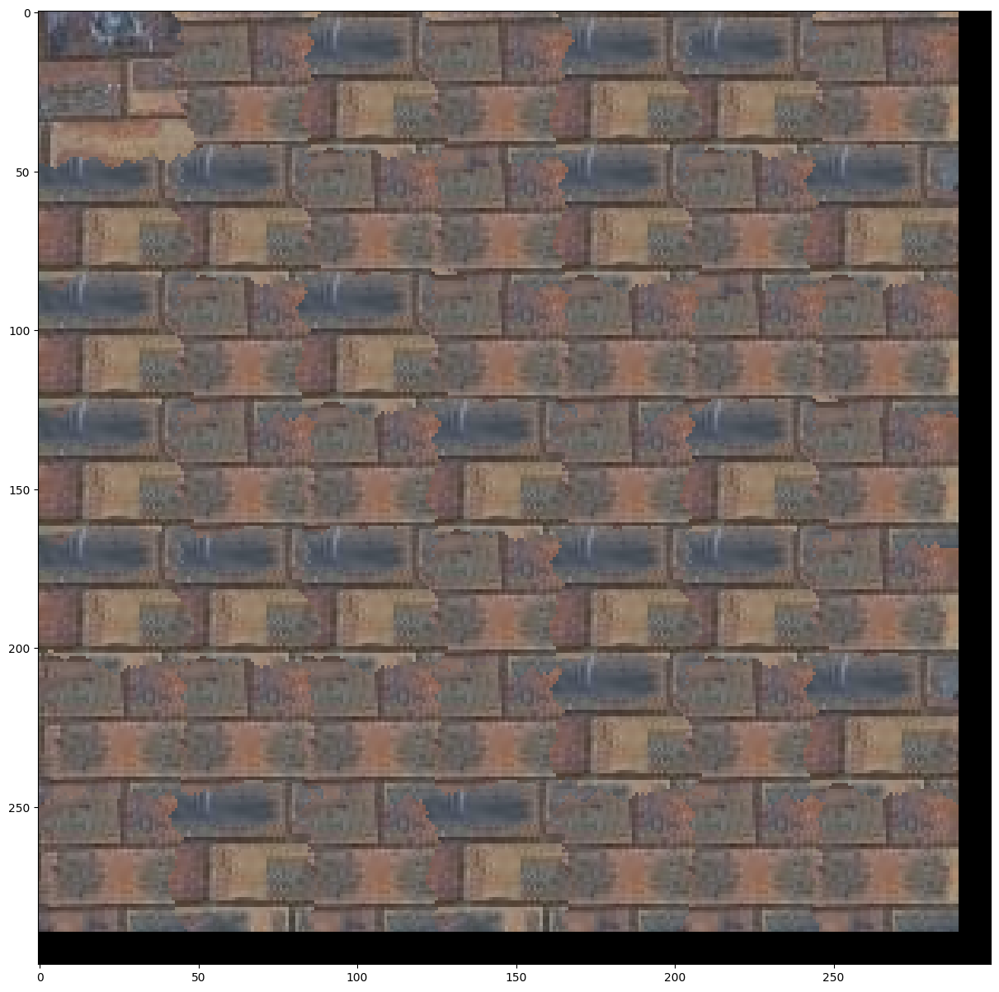

In [52]:
sample_img_fn = 'samples/bricks_small.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 300 # change these parameters as needed
patch_size = 50
overlap = 10
tol = 3
res = quilt_cut(sample_img, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)

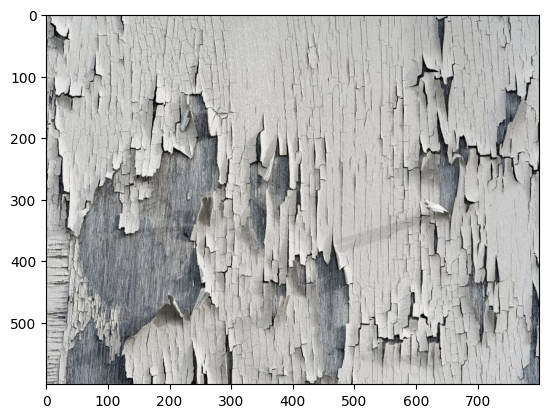

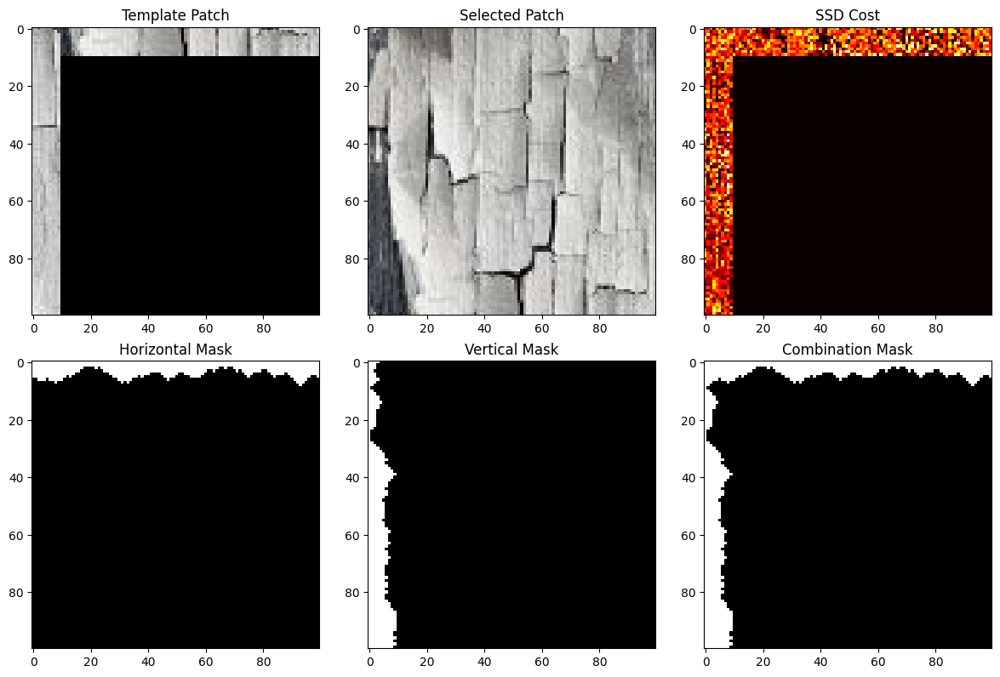

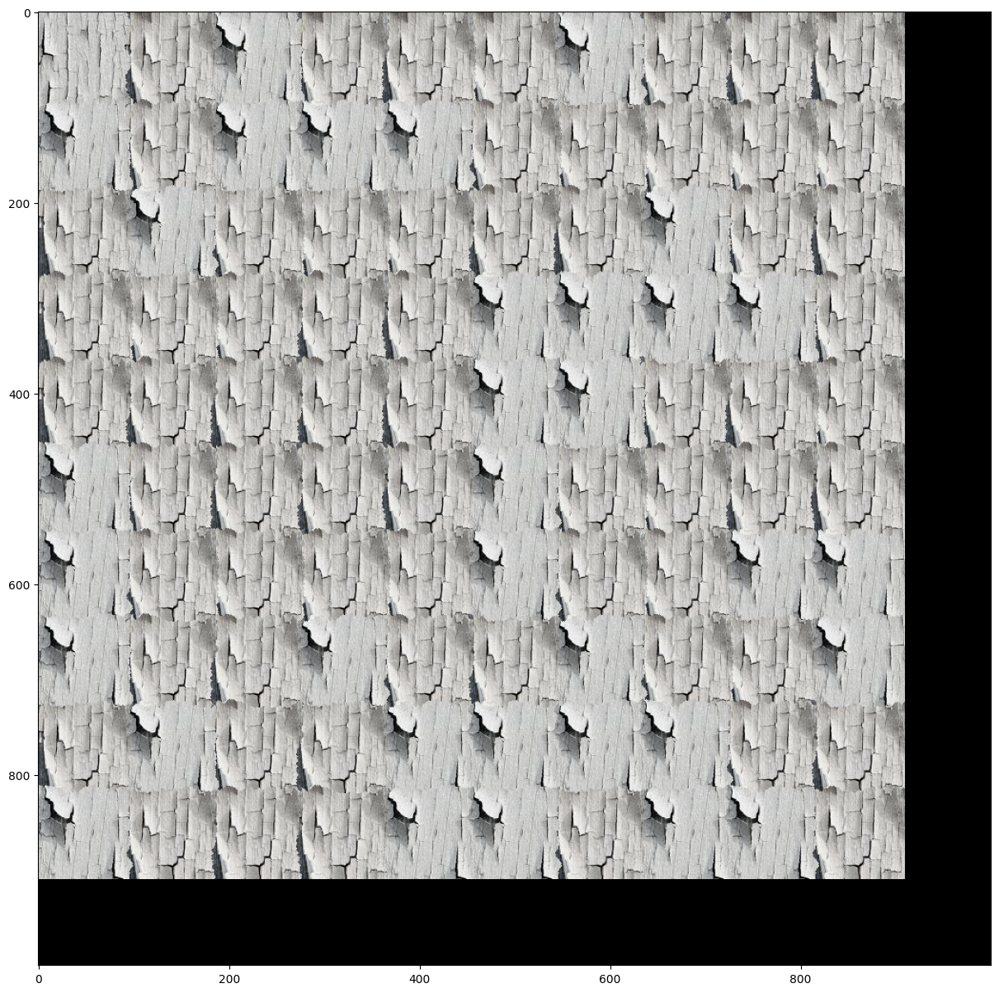

In [45]:
sample_img_fn = 'samples/texture_bark.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 1000 # change these parameters as needed
patch_size = 100
overlap = 10
tol = 3
res = quilt_cut(sample_img, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)

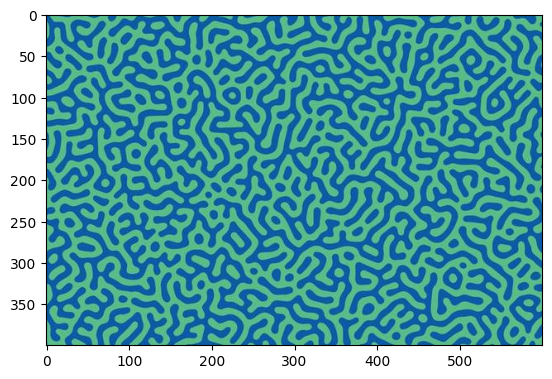

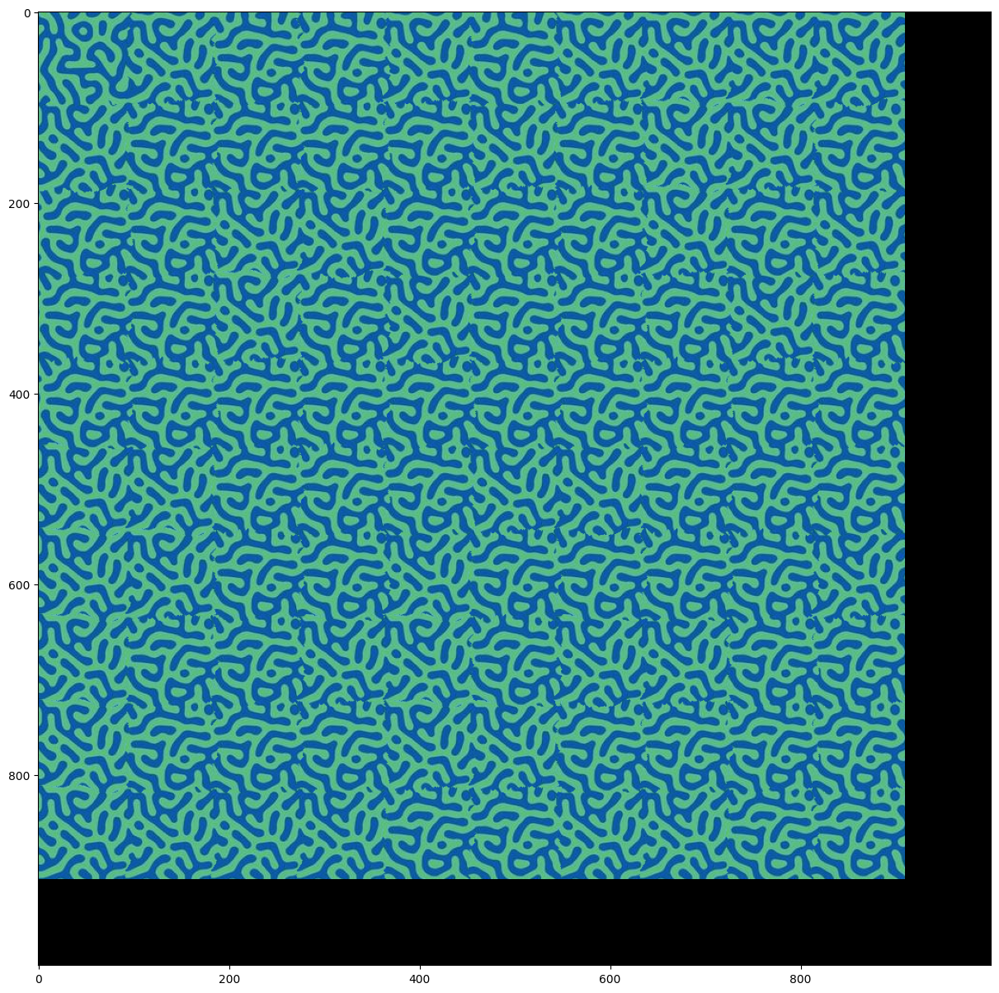

In [53]:
sample_img_fn = 'samples/pattern.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 1000 # change these parameters as needed
patch_size = 100
overlap = 10
tol = 3
res = quilt_cut(sample_img, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)

### part IV: Texture Transfer (30 pts)

In [18]:
import numpy as np

def modified_patch(source, guidance):
    patch_size = guidance.shape[0]
    # print(source.shape)
    # print(guidance.shape)

    h, w, z = source.shape
    ssd = np.zeros((h - patch_size, w - patch_size))  # Preallocate SSD array

    for i in range(h - patch_size):
        for j in range(w - patch_size):
            patch = source[i:i+patch_size, j:j+patch_size, :]
            ssd[i, j] = (np.sum((patch - guidance) ** 2))  # SSD computation
    return ssd

                
def texture_transfer(sample, patch_size, overlap, tol, guidance_im, alpha):
    """
    Samples square patches of size patchsize from sample using seam finding in order to create an output image of size outsize.
    Feel free to modify function parameters
    :param sample: numpy.ndarray
    :param patch_size: int
    :param overlap: int
    :param tol: float
    :param guidance_im: target overall appearance for the output
    :param alpha: float 0-1 for strength of target
    :return: numpy.ndarray
    """
    h, w, z = guidance_im.shape
    output = np.zeros((h, w, sample.shape[2]), dtype=sample.dtype)

    for y in range(0, h - patch_size + 1 , patch_size - overlap):
        for x in range(0, w - patch_size + 1, patch_size - overlap):
            
            # template = np.zeros((patch_size, patch_size, sams z zple.shape[2]))
            mask = np.zeros((patch_size, patch_size, sample.shape[2]))
            guidance = guidance_im[y:y+patch_size, x:x+patch_size]
            template = output[y:y+patch_size, x:x+patch_size]
            
            if y > 0:
                # template[:overlap, :, :] = output[y:y+overlap, x:x+patch_size, :]
                mask[:overlap, :, :] = 1
            if x > 0:
                # template[:, :overlap, :] = output[y:y+patch_size, x:x+overlap, :]
                mask[:, :overlap, :] = 1
            valid_h, valid_w = sample.shape[0] - patch_size, sample.shape[1] - patch_size

            ssd_cost1 = ssd_patch(template, mask, sample) 
            ssd_cost2 = modified_patch(sample, guidance)
            ssd_cost1 = ssd_cost1[:valid_h, :valid_w]
            ssd_cost = ssd_cost1 * alpha + ssd_cost2 * (1-alpha)
            
            i, j = choose_sample(ssd_cost, tol)
            patch = sample[i:i+patch_size, j:j+patch_size, :]
            mask_v = np.zeros((patch_size, patch_size, sample.shape[2]))
            mask_h = np.zeros((patch_size, patch_size, sample.shape[2]))
            if y > 0:
                vertical_error = (output[y:y+overlap, x:x+patch_size, :] - patch[:overlap, :, :])**2
                bndcost_v = vertical_error.sum(axis=2)  # Sum over color channels
                mask1 = 1-cut(bndcost_v)
                # print(mask_v.shape)
                mask_v[:overlap, :, :] = np.repeat(mask1[:, :, np.newaxis], 3, axis=2)
            if x > 0:
                horizontal_error = (output[y:y+patch_size, x:x+overlap, :] - patch[:, :overlap, :])**2
                bndcost_h = horizontal_error.sum(axis=2)  # Sum over color channels
                # np.repeat(a[:, :, np.newaxis], 3, axis=2) https://stackoverflow.com/questions/32171917/how-to-copy-a-2d-array-into-a-3rd-dimension-n-times

                mask2 = 1-cut(bndcost_h.T).T 
                # print(mask_h.shape)
                mask_h[:, :overlap, :] = np.repeat(mask2[:, :, np.newaxis], 3, axis=2)
            # print(mask_v.shape, mask_h.shape)
            mask = np.logical_or(mask_v, mask_h).astype(np.uint8)

            if ((y+patch_size) < h) and ((x+patch_size) < w):
                output[y:y+patch_size, x:x+patch_size, :] = patch * (1-mask) + output[y:y+patch_size, x:x+patch_size, :] * ( mask)
    
    return output



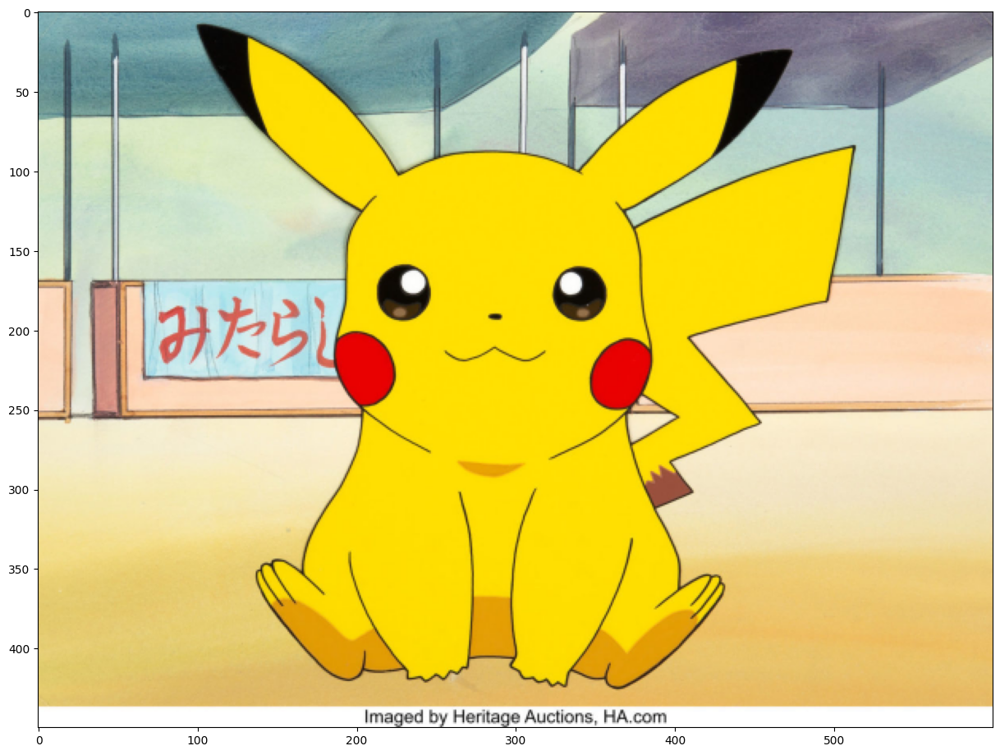

In [48]:
# load/process appropriate input texture and guidance images

# Ensure it's in floating-point format for processing
texture_img_fn = 'samples/texture_cyan.jpg' # feel free to change
texture_img = cv2.cvtColor(cv2.imread(texture_img_fn), cv2.COLOR_BGR2RGB)
texture_img = cv2.resize(texture_img, (texture_img.shape[1] // 8, texture_img.shape[0] // 8), interpolation=cv2.INTER_AREA)

guidance_img_fn = 'samples/pikachu.jpg'
guidance_img = cv2.cvtColor(cv2.imread(guidance_img_fn), cv2.COLOR_BGR2RGB)
height, width = guidance_img.shape[:2]
guidance_img = cv2.resize(guidance_img, (width // 2, height // 2), interpolation=cv2.INTER_AREA)

plt.figure(figsize=(15,15))
plt.imshow(guidance_img)
plt.show()

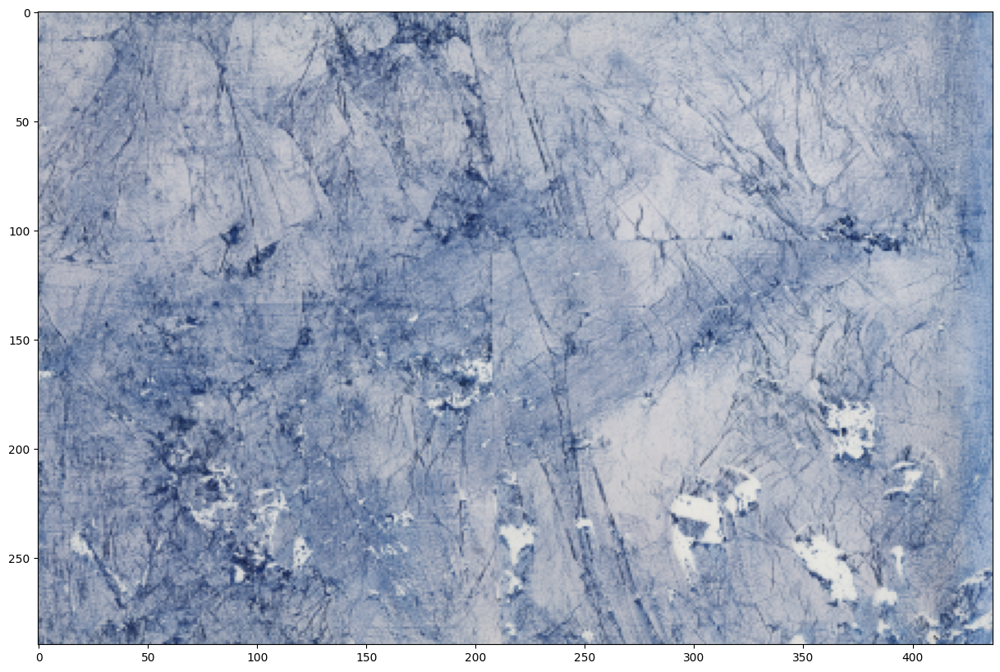

In [ ]:
plt.figure(figsize=(15,15))
plt.imshow(texture_img)
plt.show()
#

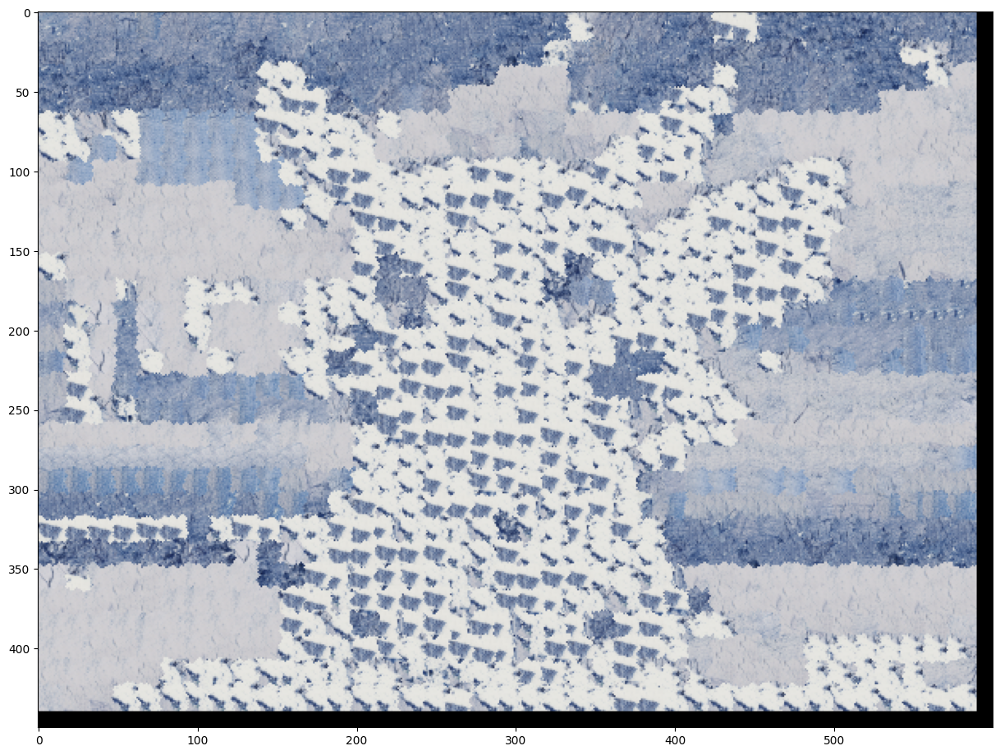

In [257]:
patch_size = 20
overlap = 5
tol = 3
alpha = 0.5
res = texture_transfer(texture_img, patch_size, overlap, tol, guidance_img, alpha)

plt.figure(figsize=(15,15))
plt.imshow(res)
plt.show()

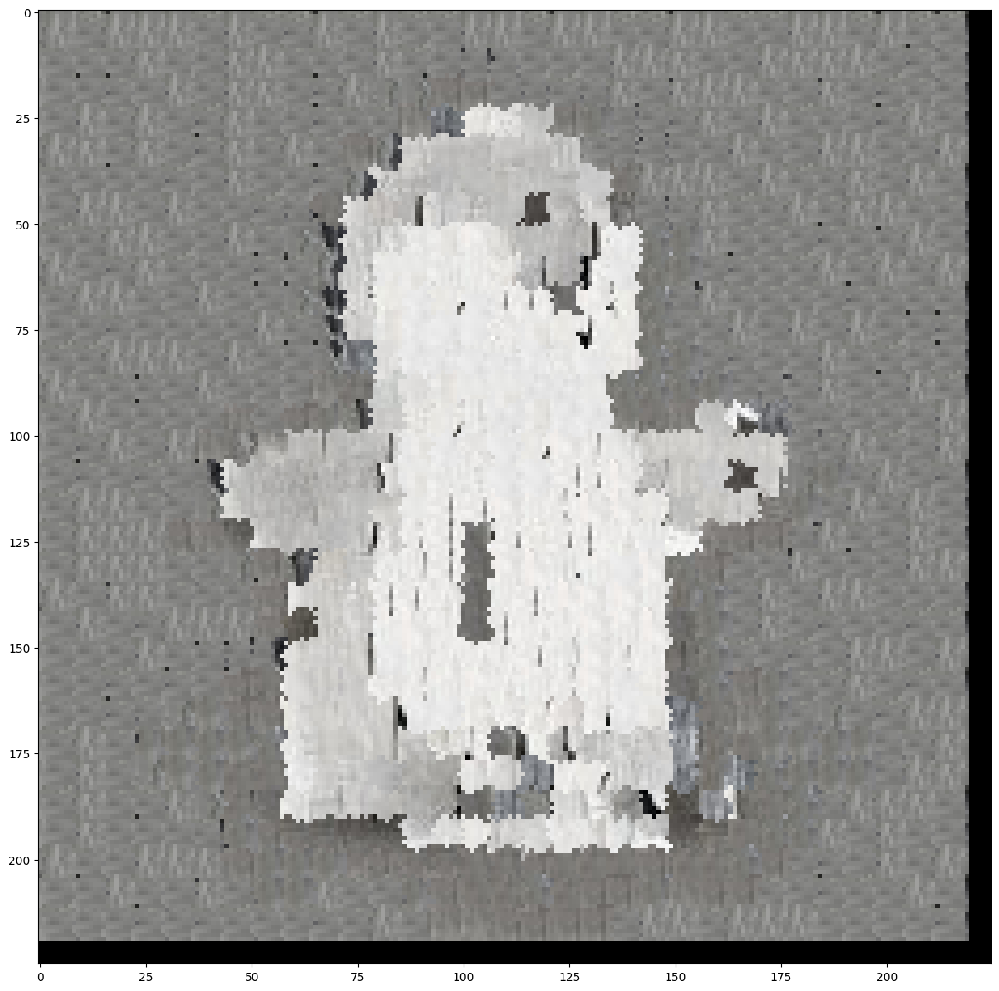

In [ ]:
# Ensure it's in floating-point format for processing
texture_img_fn1 = 'samples/texture_bark.jpg' # feel free to change
texture_img1 = cv2.cvtColor(cv2.imread(texture_img_fn1), cv2.COLOR_BGR2RGB)
patch_size = 10
overlap = 3
tol = 3
alpha = 0.5

guidance_img_fn1 = 'samples/jellycat.jpg'
guidance_img1 = cv2.cvtColor(cv2.imread(guidance_img_fn1), cv2.COLOR_BGR2RGB)
res1 = texture_transfer(texture_img1, patch_size, overlap, tol, guidance_img1, alpha)

plt.figure(figsize=(15,15))
plt.imshow(res1)
plt.show()

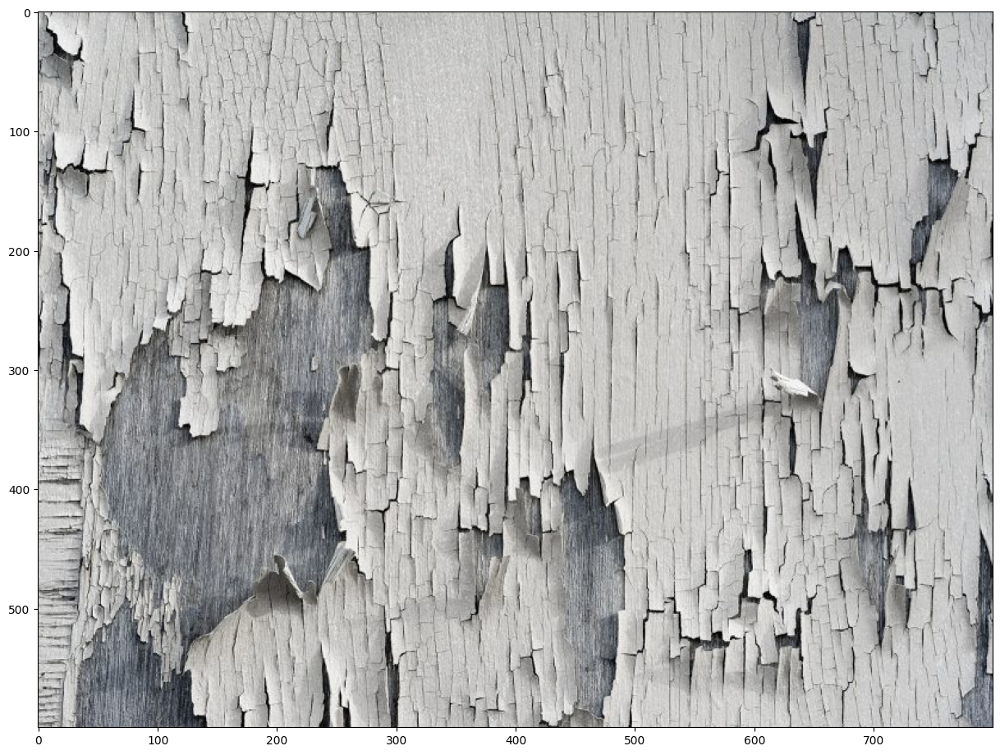

In [36]:
plt.figure(figsize=(15,15))
plt.imshow(texture_img1)
plt.show()

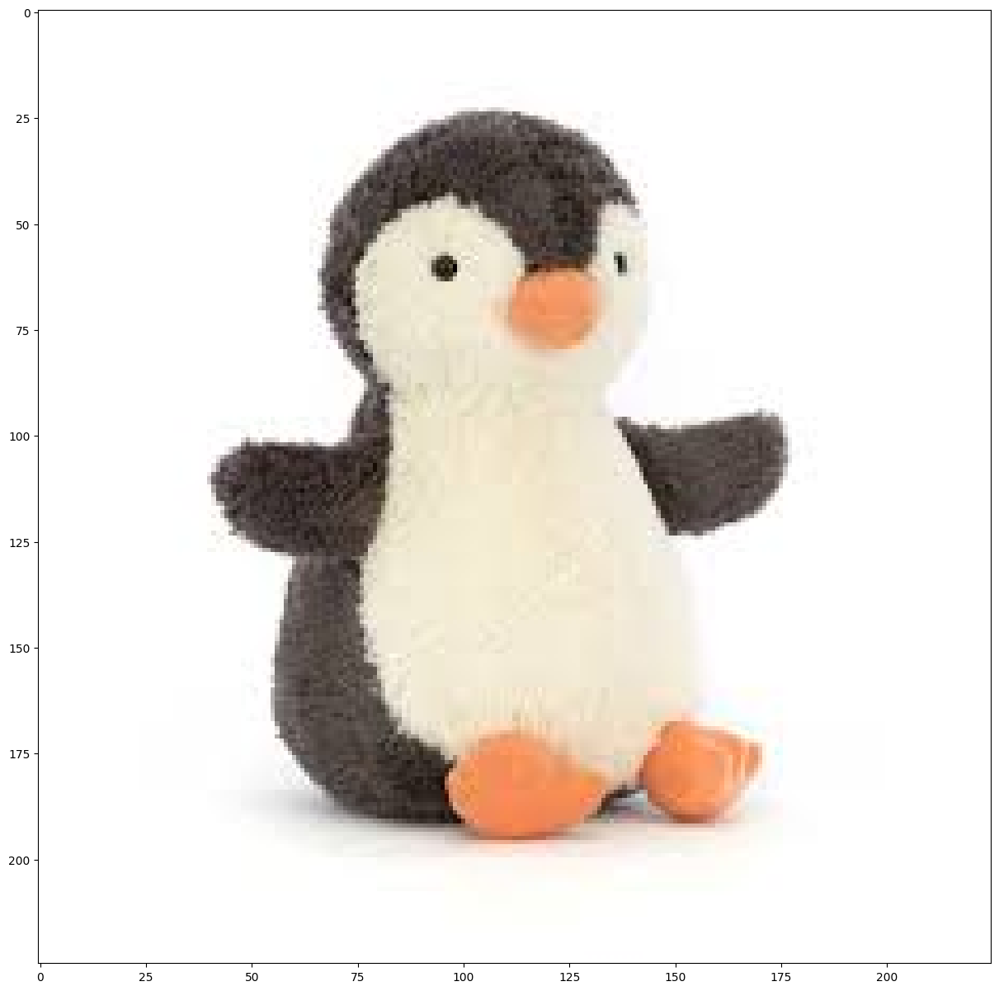

In [37]:
plt.figure(figsize=(15,15))
plt.imshow(guidance_img1)
plt.show()

### Bells & Whistles

(15 pts) Implement the iterative texture transfer method described in the paper. Compare to the non-iterative method for two examples.

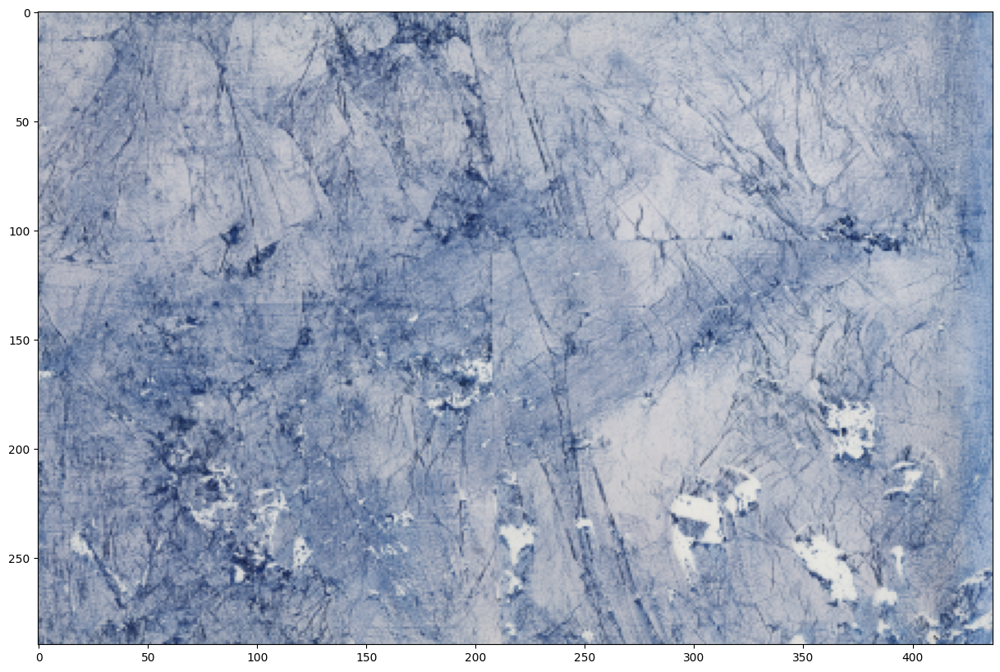

In [13]:
import cv2
texture_img_fn = 'samples/texture_cyan.jpg' # feel free to change
texture_img = cv2.cvtColor(cv2.imread(texture_img_fn), cv2.COLOR_BGR2RGB)
texture_img = cv2.resize(texture_img, (texture_img.shape[1] // 8, texture_img.shape[0] // 8), interpolation=cv2.INTER_AREA)
plt.figure(figsize=(15,15))
plt.imshow(texture_img)
plt.show()

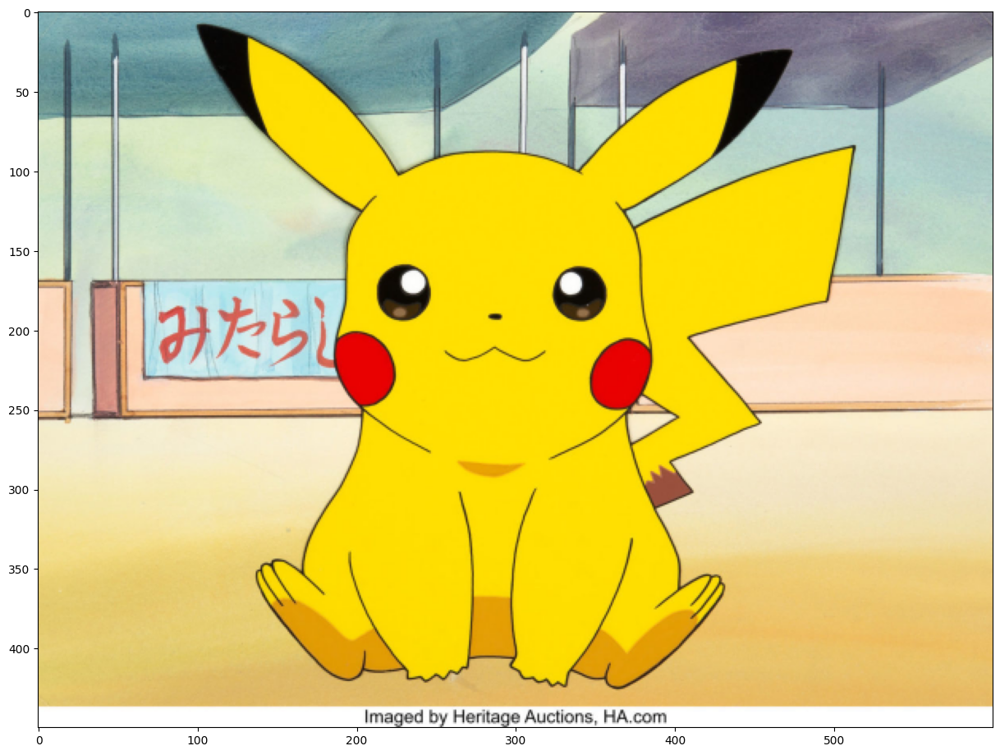

In [14]:
guidance_img_fn = 'samples/pikachu.jpg'
guidance_img = cv2.cvtColor(cv2.imread(guidance_img_fn), cv2.COLOR_BGR2RGB)
height, width = guidance_img.shape[:2]
guidance_img = cv2.resize(guidance_img, (width // 2, height // 2), interpolation=cv2.INTER_AREA)
plt.figure(figsize=(15,15))
plt.imshow(guidance_img)
plt.show()

0
1
2


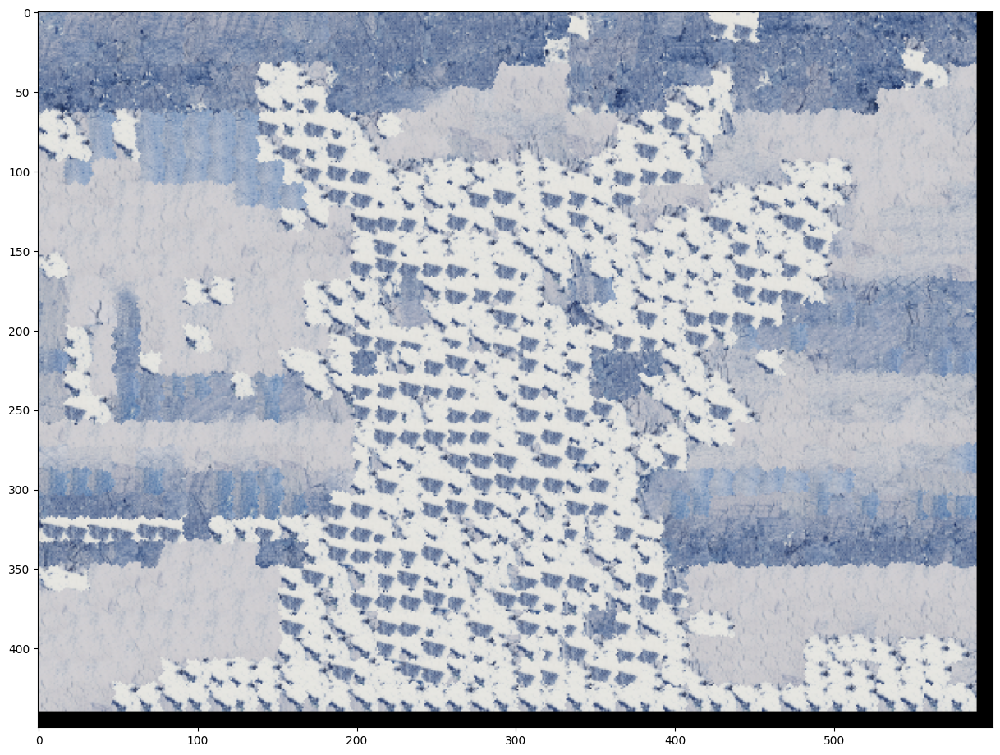

In [19]:
patch_size = 20
overlap = 5
tol = 3
alpha = 0.5
for i in range(3):
    alpha = 0.1 + 0.8*(i)/(3-1)
    res = texture_transfer(texture_img, patch_size, overlap, tol, guidance_img, alpha)
    patch_size = int(2/3*patch_size)
    guidance_img = res
    print(i)

plt.figure(figsize=(15,15))
plt.imshow(res)
plt.show()

(up to 20 pts) Use a combination of texture transfer and blending to create a face-in-toast image like the one on top. To get full points, you must use some type of blending, such as feathering or Laplacian pyramid blending.

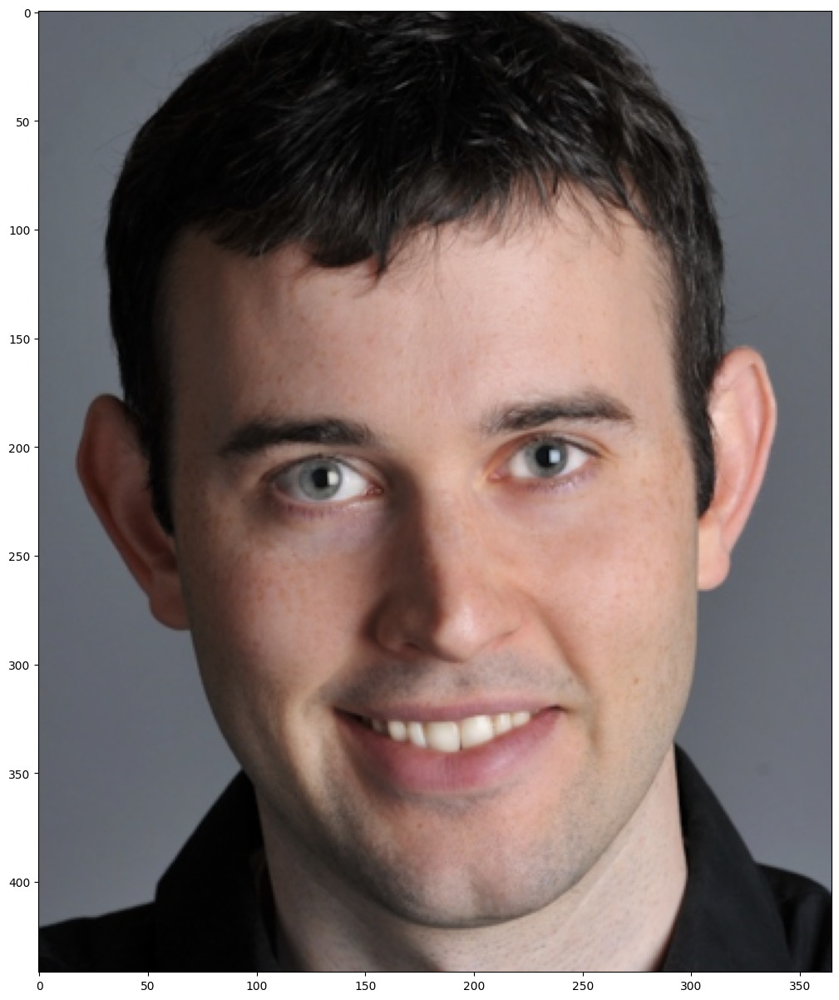

In [85]:
# load/process appropriate input texture and guidance images

# Ensure it's in floating-point format for processing
texture_img_fn = 'samples/toast.jpg' # feel free to change
texture_img = cv2.cvtColor(cv2.imread(texture_img_fn), cv2.COLOR_BGR2RGB)
guidance_img_fn = 'samples/DerekSmall.jpg'
guidance_img = cv2.cvtColor(cv2.imread(guidance_img_fn), cv2.COLOR_BGR2RGB)
# Load the image (assuming guidance_img is already a NumPy array)
image = guidance_img  # Or use cv2.imread("guidance_img.png")
new_texture_img = texture_img[50:450,50:450]
# Get dimensions
height, width = image.shape[:2]  # OpenCV stores (height, width, channels)
guidance_img = cv2.resize(image, (width // 2, height // 2), interpolation=cv2.INTER_AREA)
plt.figure(figsize=(15,15))
plt.imshow(guidance_img)
plt.show()

In [86]:
texture_img.shape

(484, 500, 3)

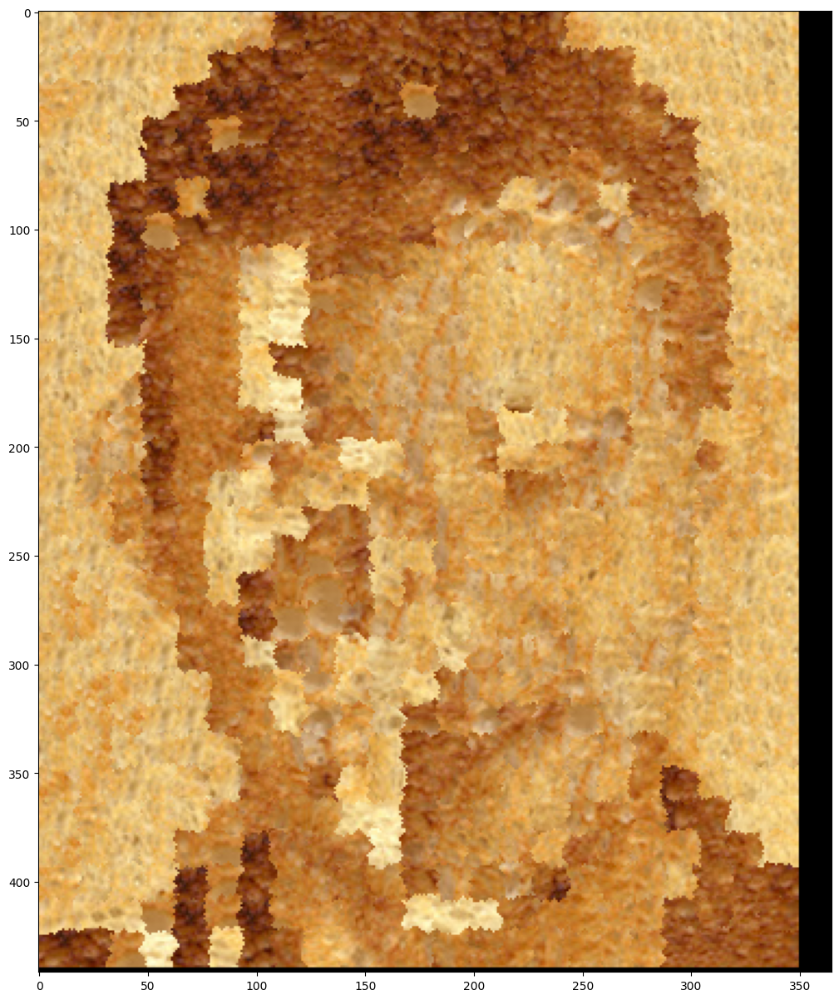

In [87]:
patch_size = 20
overlap = 5
tol = 3
alpha = 0.5

bread_res = texture_transfer(new_texture_img, patch_size, overlap, tol, guidance_img, alpha)

plt.figure(figsize=(15,15))
plt.imshow(bread_res)
plt.show()

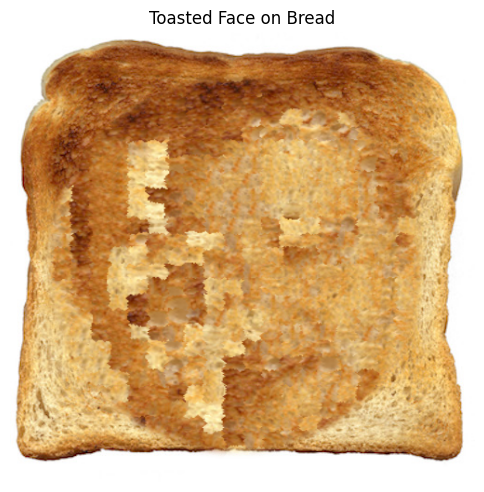

In [93]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
foreground = bread_res
background = texture_img
foreground = cv2.resize(foreground, (background.shape[1], background.shape[0]))
# Convert guidance image to grayscale
gray_foreground = cv2.cvtColor(foreground, cv2.COLOR_RGB2GRAY)

# # Apply Gaussian Blur
# blurred_fg = cv2.GaussianBlur(gray_foreground, (15, 15), 0)

# # Convert to binary mask using thresholding
# _, mask = cv2.threshold(blurred_fg, 100, 255, cv2.THRESH_BINARY)

# # Invert mask so that face is the "painted" part
# mask = cv2.bitwise_not(mask)
mask = np.zeros(foreground.shape[:2], dtype="uint8")
cv2.circle(mask, (242, 250), 200, 255, -1)
mask = cv2.GaussianBlur(mask, (21, 21), 0)

# masked = cv2.bitwise_and(bread_res, bread_res, mask=mask)

# Normalize mask to range [0,1] and expand to 3 channels
alpha = (mask.astype(float) / 255.0)
alpha = np.stack([alpha] * 3, axis=-1)  # Shape: (H, W, 3)
# Blend images using alpha compositing
blended = (alpha * foreground) + ((1 - alpha) * background)
blended = blended.astype(np.uint8)  # Convert to valid image format
# new_blended = 0.8*blended+0.2*background
# Display using Matplotlib
plt.figure(figsize=(6, 6))
plt.imshow((blended))  # Convert BGR to RGB for correct display
plt.axis("off")  # Hide axis for a cleaner look
plt.title("Toasted Face on Bread")
plt.show()


(up to 40 pts) Extend your method to fill holes of arbitrary shape for image completion. In this case, patches are drawn from other parts of the target image. For the full 40 pts, you should implement a smart priority function (e.g., similar to Criminisi et al.).

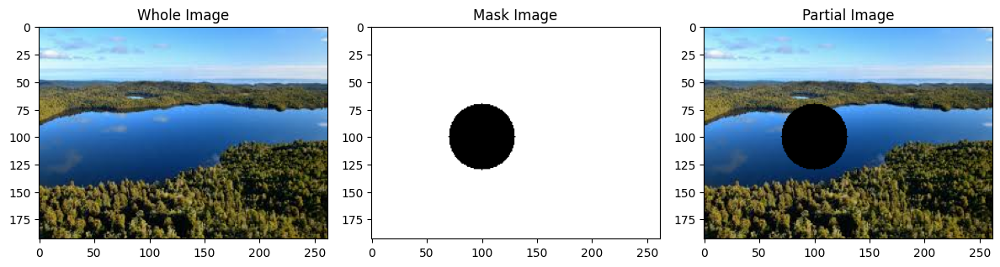

In [ ]:
# import heapq
# import random
# import numpy as np
# import cv2



# def compute_gradient(image):
#     """Compute the gradient magnitude of the image (edge strength)."""
#     grad_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
#     grad_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
#     grad_mag = cv2.magnitude(grad_x, grad_y)
#     return grad_mag

# def compute_confidence(image, mask):
#     """Compute confidence map based on how well the surrounding known pixels predict the missing pixels."""
#     confidence = np.zeros_like(mask, dtype=np.float64)
#     for i in range(1, image.shape[0] - 1):
#         for j in range(1, image.shape[1] - 1):
#             if mask[i, j] == 0 and (i+2 < image.shape[0]-1) and (j+2 < image.shape[1]-1):  # Only consider missing regions
#                 known_neighbors = image[i-1:i+2, j-1:j+2][mask[i-1:i+2, j-1:j+2] == 1]
#                 if len(known_neighbors) > 0:
#                     confidence[i, j] = np.mean(known_neighbors)  # Average intensity from known pixels
#     return confidence

# def random_patch_sample(image, mask, hole_x, hole_y, patch_size=5, search_radius=20, max_attempts=20):
#     """Randomly sample a valid patch from the known region near the missing pixel."""
#     half_patch = patch_size // 2
#     search_x_min = max(hole_x - search_radius, half_patch)
#     search_x_max = min(hole_x + search_radius, image.shape[0] - half_patch)
#     search_y_min = max(hole_y - search_radius, half_patch)
#     search_y_max = min(hole_y + search_radius, image.shape[1] - half_patch)

#     valid_patches = [
#         (i, j) for i in range(search_x_min, search_x_max)
#                for j in range(search_y_min, search_y_max)
#                if mask[i - half_patch:i + half_patch + 1, j - half_patch:j + half_patch + 1].all()
#     ]

#     attempts = 0
#     while attempts < max_attempts:
#         rand_x, rand_y = random.choice(valid_patches)
        
#         # Extract the patch from the image and mask
#         patch = image[rand_x - half_patch:rand_x + half_patch + 1, rand_y - half_patch:rand_y + half_patch + 1]
#         # print(patch.shape)
#         # mask_patch = mask[rand_x - half_patch:rand_x + half_patch + 1, rand_y - half_patch:rand_y + half_patch + 1]

#         # If the patch does not contain any zero values, return it
#         if np.all(patch != 0):  # All pixels in the patch are known (not zero)
#             return rand_x, rand_y, patch

#         attempts += 1

#     return None 
# def find_boundary(mask):
#     """Find boundary pixels (pixels next to a hole)."""
#     boundary = []
#     for i in range(1, mask.shape[0] - 1):
#         for j in range(1, mask.shape[1] - 1):
#             if mask[i, j] == 0:  # Inside the hole
#                 neighbors = mask[i-1:i+2, j-1:j+2]
#                 if np.any(neighbors == 1):  # Has known neighbor
#                     boundary.append((i, j))
#     return boundary

def illustrate_patch(whole, mask, partial, result):
    fig, axes = plt.subplots(1, 3, figsize=(12, 8))
    axes[0].imshow(whole)
    axes[0].set_title("Whole Image")
    
    axes[1].imshow(mask, cmap = "gray")
    axes[1].set_title("Mask Image")

    axes[2].imshow(partial)
    axes[2].set_title("Partial Image")

    # axes[1, 1].imshow(result)
    # axes[1, 1].set_title("Result")

    plt.tight_layout()
    plt.show()

# def inpaint_image(image, mask, patch_size=5, alpha=1, beta=1, max_iter=30000):
#     """Perform image inpainting by iteratively filling the missing regions, starting from edges."""
#     result = image.copy()
#     result[mask == 0] = 0  # Ensure masked pixels are unknown at the start
    
#     gradient = compute_gradient(result)
#     confidence = compute_confidence(result, mask)
    
#     # Initialize priority queue (higher priority = first processed)
#     priority_queue = []
#     boundary_pixels = find_boundary(mask)

#     for x, y in boundary_pixels:
#         priority = alpha * np.sum(gradient[x, y]) + beta * 1/((confidence[x, y] + 1e-6))
#         heapq.heappush(priority_queue, (-priority, x, y))  # Use negative priority (max-heap behavior)

#     iterations = 0
#     while priority_queue and iterations < max_iter:
#         _, hole_x, hole_y = heapq.heappop(priority_queue)

#         # Randomly sample a patch from known regions
#         random_patch_info = random_patch_sample(result, mask, hole_x, hole_y, patch_size)
#         if random_patch_info is not None:
#             i, j, patch = random_patch_info
#             patch_half = patch_size // 2

#             # Fill the hole with the randomly sampled patch
#             result[hole_x - patch_half: hole_x + patch_half + 1,
#                    hole_y - patch_half: hole_y + patch_half + 1] = patch

#             # Update the mask and confidence
#             mask[hole_x - patch_half: hole_x + patch_half + 1,
#                  hole_y - patch_half: hole_y + patch_half + 1] = 1  # Mark as known
#             confidence = compute_confidence(result, mask)  # Recalculate confidence

#             # Add newly exposed boundary pixels to the queue
#             new_boundary = find_boundary(mask)
         
#             for x, y in new_boundary:
#                 if mask[x, y] == 0:  # Still part of the hole
#                     priority = alpha * np.sum(gradient[x, y]) + beta * (1 / (confidence[x, y] + 1e-6))
#                     heapq.heappush(priority_queue, (-priority, x, y))

#         iterations += 1
#     print(iterations)
#     return result

# # Load the image and mask (holes to fill)

# whole_pic =  cv2.cvtColor(cv2.imread("./samples/lake.jpg"), cv2.COLOR_BGR2RGB)
# image = whole_pic
# mask = np.zeros(whole_pic.shape[:2], dtype="uint8")
# cv2.circle(mask, (100, 100), 30, 255, -1)
# mask = 1-(mask.astype(float) / 255.0)
# # Ensure mask is binary (0 for hole, 255 for known region)
# mask = (mask > 0).astype(np.uint8)
illustrate_patch(image, mask, image*np.stack([mask] * 3, axis=-1).astype(np.uint8), inpaint_image )
# partial_img = image*np.stack([mask] * 3, axis=-1).astype(np.uint8)
# # Inpaint the image
# inpainted_image = inpaint_image(image, mask)

In [58]:
def illustrate_patch(whole, mask, partial, result):
    fig, axes = plt.subplots(1, 3, figsize=(12, 8))
    axes[0].imshow(whole)
    axes[0].set_title("Whole Image")
    
    axes[1].imshow(mask, cmap = "gray")
    axes[1].set_title("Mask Image")

    axes[2].imshow(partial)
    axes[2].set_title("Partial Image")

    # axes[1, 1].imshow(result)
    # axes[1, 1].set_title("Result")

    plt.tight_layout()
    plt.show()

In [54]:
import cv2
import numpy as np
import random

def compute_priority(confidence, gradient, fill_front, patch_size=9):
    """Compute priority for each point on the fill front."""
    priority = {}
    half_patch = patch_size // 2

    for p in fill_front:
        y, x = p  # Unpack the NumPy array
        
        # Extract patch
        y1, y2 = max(0, y - half_patch), min(confidence.shape[0], y + half_patch + 1)
        x1, x2 = max(0, x - half_patch), min(confidence.shape[1], x + half_patch + 1)

        patch_conf = confidence[y1:y2, x1:x2]
        confidence_term = np.sum(patch_conf) / ((y2 - y1) * (x2 - x1))  # Average confidence

        # Data term (gradient magnitude)
        data_term = np.linalg.norm(gradient[y, x])

        # Compute priority
        priority[tuple(p)] = confidence_term * data_term  # P(p) = C(p) * D(p)

    return priority

# def find_best_patch(image, target_patch, source_region):
#     """Find the best matching exemplar (source patch) for the target patch."""
#     min_distance = float('inf')
#     best_patch = None
#     h, w, _ = target_patch.shape
    
#     for p in source_region:
#         y, x = p
#         if y + h < image.shape[0] and x + w < image.shape[1]:
#             source_patch = image[y:y+h, x:x+w]
#             distance = np.sum((target_patch - source_patch) ** 2)
#             if distance < min_distance:
#                 min_distance = distance
#                 best_patch = np.array([y, x])  # Store as NumPy array
                    
    # return best_patch

def find_best_patch(image, target_patch, mask_patch, source_region):
    """Find the best matching source patch that aligns best with the unmasked region of the target patch."""
    min_distance = float('inf')
    best_patch = None
    h, w, _ = target_patch.shape

    for p in source_region:
        y, x = p
        if y + h < image.shape[0] and x + w < image.shape[1]:
            source_patch = image[y:y+h, x:x+w]

            # Compute the difference only for the unmasked pixels
            diff = (target_patch - source_patch) * np.stack([mask_patch] * 3, axis=-1).astype(np.uint8)  # Zero out masked regions
            distance = np.sum(diff ** 2)  # Compute the sum of squared differences
            
            if distance < min_distance:
                min_distance = distance
                best_patch = np.array([y, x])  # Store best matching patch coordinates
                    
    return best_patch


def update_image(image, target_patch_coords, best_patch_coords, patch_size, masked_image):
    """Copy best matching patch into the target region."""
    y_t, x_t = target_patch_coords
    y_s, x_s = best_patch_coords
    masked_image[y_t:y_t+patch_size, x_t:x_t+patch_size] = image[y_s:y_s+patch_size, x_s:x_s+patch_size]

def inpaint_exemplar_based(image, mask, patch_size=9):
    """Main function to perform exemplar-based inpainting."""
    confidence = mask.astype(float)  # Confidence values
    masked_image = image * np.stack([mask] * 3, axis=-1).astype(np.uint8)

    source_region = np.column_stack(np.where(mask == 1))  # Non-missing pixels
    target_region = np.column_stack(np.where(mask==0))  # Missing pixels

    processed = set()  # Store processed pixels
    
    while len(target_region) > 0:
        # 1a. Identify fill front (boundary of the missing region)
        print(f"Remaining target region size: {len(target_region)}")
        fill_front_array = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)[0][0]
        fill_front = fill_front_array.reshape(-1, 2)  # Convert to (N,2) NumPy array
        
        # Filter out already processed points
        fill_front = np.array([tuple(p) for p in fill_front if tuple(p) not in processed and mask[p[0], p[1]] == 0])

        if len(fill_front) == 0:
            fill_front=np.column_stack(np.where(mask == 0))
            # print(fill_front)
            

        # 1b. Compute priorities
        gradient = cv2.Sobel(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY), cv2.CV_64F, 1, 1)
        priority = compute_priority(confidence, gradient, fill_front)
        
        # 2a. Select highest priority patch
        top_patches = sorted(priority, key=priority.get, reverse=True)[:3]
        p_hat = np.array(random.choice(top_patches))  # Randomly select from top 3
        
      # 2b. Find best matching patch from source region
        y_p, x_p = p_hat
        half_patch = patch_size // 2
        if (mask[y_p,x_p]==1):
            continue
        
        # Compute patch boundaries correctly
        y1, y2 = max(0, y_p - half_patch), min(confidence.shape[0], y_p + half_patch + 1)
        x1, x2 = max(0, x_p - half_patch), min(confidence.shape[1], x_p + half_patch + 1)

        # Extract target patch and mask patch correctly
        target_patch = image[y1:y2, x1:x2]
        mask_patch = mask[y1:y2, x1:x2] # np.stack([mask_patch] * 3, axis=-1).astype(np.uint8) 

        best_patch_coords = find_best_patch(image, target_patch, mask_patch, source_region)
        if best_patch_coords is None:
            print("Warning: No valid patch found, skipping iteration.")
            continue  # Skip this iteration

        print(p_hat)
        # 2c. Copy best patch to the missing region
        y_t, x_t = p_hat
        y_s, x_s = best_patch_coords
        h_t = min(patch_size, image.shape[0] - y_t)
        w_t = min(patch_size, image.shape[1] - x_t)

        h_s = min(patch_size, image.shape[0] - y_s)
        w_s = min(patch_size, image.shape[1] - x_s)

        # Ensure both patches have the same size
        h, w = min(h_t, h_s), min(w_t, w_s)

        # Copy the patch with proper size handling
        masked_image[y_t:y_t+h, x_t:x_t+w] = image[y_s:y_s+h, x_s:x_s+w]
        
        # 3. Update confidence values
        confidence[y_p:y_p+patch_size, x_p:x_p+patch_size] = confidence[y_p, x_p]

        # Update mask (filled region)
        mask[y_p:y_p+patch_size, x_p:x_p+patch_size] = 1

        # Add processed pixels to the set
        for y in range(y_p, y_p+patch_size):
            for x in range(x_p, x_p+patch_size):
                processed.add((y, x))

        print("Patch processed and updated.")

        # Recalculate target region
        target_region = np.column_stack(np.where(mask == 0))


    return masked_image, mask

# Load image and mask
image = cv2.cvtColor(cv2.imread("./samples/lake.jpg"), cv2.COLOR_BGR2RGB)
mask = np.zeros(image.shape[:2], dtype="uint8")
cv2.circle(mask, (100, 100), 30, 255, -1)
mask = ((1 - (mask.astype(float) / 255.0)) > 0).astype(np.uint8)

# Perform inpainting

result,mask = inpaint_exemplar_based(image, mask)

0
Remaining target region size: 2821
[ 72 110]
Patch processed and updated.
Remaining target region size: 2759
[118  80]
Patch processed and updated.
Remaining target region size: 2691
[ 87 126]
Patch processed and updated.
Remaining target region size: 2664
[129  95]
Patch processed and updated.
Remaining target region size: 2654
[126  95]
Patch processed and updated.
Remaining target region size: 2627
[110  80]
Patch processed and updated.
Remaining target region size: 2555
[118  77]
Patch processed and updated.
Remaining target region size: 2546
[103 129]
Patch processed and updated.
Remaining target region size: 2541
[110  72]
Patch processed and updated.
Remaining target region size: 2491
[103 126]
Patch processed and updated.
Remaining target region size: 2465
[126 111]
Patch processed and updated.
Remaining target region size: 2458
[ 88 110]
Patch processed and updated.
Remaining target region size: 2377
[110  96]
Patch processed and updated.
Remaining target region size: 2296
[

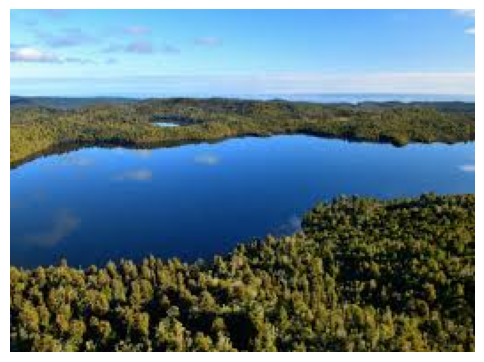

In [55]:
plt.figure(figsize=(6, 6))
plt.imshow((result))  # Convert BGR to RGB for correct display
plt.axis("off")  # Hide axis for a cleaner look
plt.show()

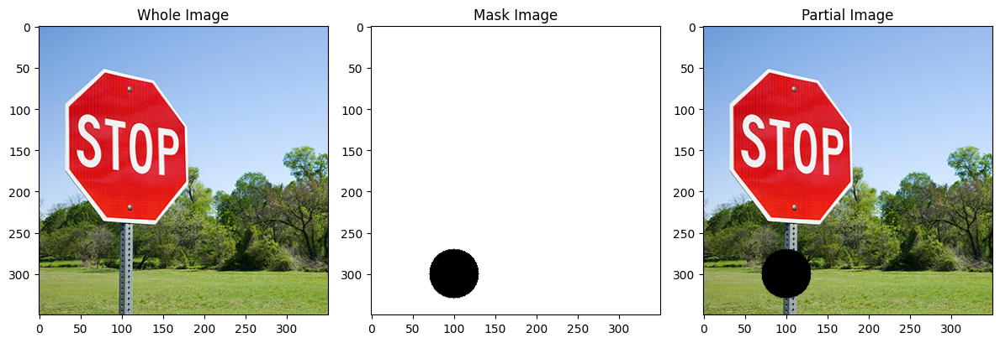

Remaining target region size: 2821
[272 110]
Patch processed and updated.
Remaining target region size: 2759
[329 107]
Patch processed and updated.
Remaining target region size: 2758
[272 108]
Patch processed and updated.
Remaining target region size: 2740
[287 127]
Patch processed and updated.
Remaining target region size: 2722
[271 100]
Patch processed and updated.
Remaining target region size: 2650
[288  73]
Patch processed and updated.
Remaining target region size: 2569
[294  71]
Patch processed and updated.
Remaining target region size: 2509
[270 100]
Patch processed and updated.
Remaining target region size: 2508
[285 125]
Patch processed and updated.
Remaining target region size: 2491
[287  73]
Patch processed and updated.
Remaining target region size: 2482
[281  77]
Patch processed and updated.
Remaining target region size: 2416
[330 100]
Patch processed and updated.
Remaining target region size: 2415
[285  75]
Patch processed and updated.
Remaining target region size: 2403
[28

In [65]:
whole_pic =  cv2.cvtColor(cv2.imread("./samples/stop-sign.jpg"), cv2.COLOR_BGR2RGB)
image = whole_pic
mask = np.zeros(whole_pic.shape[:2], dtype="uint8")
cv2.circle(mask, (100, 300), 30, 255, -1)
mask = ((1-(mask.astype(float) / 255.0)) > 0).astype(np.uint8)
# illustrate_patch(image, mask, image*np.stack([mask] * 3, axis=-1).astype(np.uint8), inpaint_image )
partial_img = image*np.stack([mask] * 3, axis=-1).astype(np.uint8)
illustrate_patch(image, mask, image*np.stack([mask] * 3, axis=-1).astype(np.uint8), image)

result,mask = inpaint_exemplar_based(image, mask)

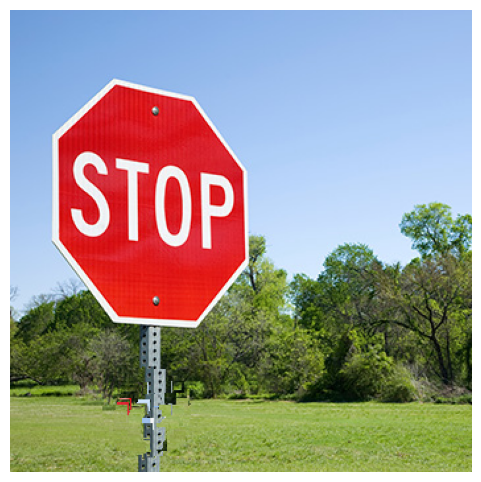

In [66]:
plt.figure(figsize=(6, 6))
plt.imshow((result))  # Convert BGR to RGB for correct display
plt.axis("off")  # Hide axis for a cleaner look
plt.show()